## 🔍 Segment 3: Dataset Examples - What Really Activates These Neurons?

### Building on Segment 2

In **Segment 2**, we used activation maximization to synthesize the "ideal" input for each neuron - artificial images optimized to maximally activate specific features. These visualizations revealed what patterns each neuron is *looking for*.

Now in **Segment 3**, we ask: **Do these patterns actually exist in real images?**

### The Approach

We'll search through ImageNet to find natural photographs that strongly activate our target neurons. This serves two purposes:

1. **Validation**: Do real images match our synthetic visualizations?
2. **Discovery**: What contexts do these features appear in naturally?

### Dataset: ImageNet

- **Full ImageNet**: 50,000 validation images (ideal, but requires download)
- **ImageNette**: 3,925 images (faster alternative, ImageNet subset)

For consistency and speed, we'll use **ImageNette** - a curated subset containing 10 ImageNet classes. This still provides diverse, high-quality natural images while being practical for exploration.

### What We'll Find

For each of neurons 0-9 in mixed4a:
- The 10 images that produce the highest activation
- The semantic categories these images belong to
- How well they match our activation maximization results


In [1]:
import torch
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader, Subset
from PIL import Image
import time
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
from lucent.modelzoo import inceptionv1
from tqdm.auto import tqdm
import json
from datetime import datetime

# Create organized output structure
OUTPUT_DIR = Path("segment_3_outputs")
IMAGES_DIR = OUTPUT_DIR / "neuron_visualizations"
COMPARISONS_DIR = OUTPUT_DIR / "synthetic_vs_real"
METADATA_DIR = OUTPUT_DIR / "metadata"

# Create directories
for dir_path in [OUTPUT_DIR, IMAGES_DIR, COMPARISONS_DIR, METADATA_DIR]:
    dir_path.mkdir(exist_ok=True, parents=True)

print(f"📁 Output structure created:")
print(f"   └─ {OUTPUT_DIR}/")
print(f"      ├─ neuron_visualizations/  (top-10 images per neuron)")
print(f"      ├─ synthetic_vs_real/       (comparison plots)")
print(f"      └─ metadata/                (statistics & reports)")

# Load model
device = "cuda" if torch.cuda.is_available() else "cpu"
model = inceptionv1(pretrained=True).to(device).eval()
print(f"\n✅ Model loaded on {device.upper()}")

# Dataset setup
print("\n📦 Setting up dataset...")

# Check if ImageNet is available, otherwise use ImageNette
DATASET_PATH = "./imagenette2-320/val"

if not Path(DATASET_PATH).exists():
    print("📥 Downloading ImageNette (ImageNet subset, ~50MB)...")
    !wget -q https://s3.amazonaws.com/fast-ai-imageclas/imagenette2-320.tgz
    !tar -xzf imagenette2-320.tgz
    print("✅ ImageNette downloaded")

# Standard ImageNet preprocessing
transform = T.Compose([
    T.Resize(256),
    T.CenterCrop(224),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Load dataset
dataset = ImageFolder(root=DATASET_PATH, transform=transform)
print(f"✅ Dataset loaded: {len(dataset):,} images")
print(f"   Classes: {dataset.classes}")

# Optional: Use subset for quick testing
USE_FULL_DATASET = True  # Set to False for quick testing

if not USE_FULL_DATASET:
    print("\n⚡ Using subset for quick testing (1000 images)")
    dataset = Subset(dataset, list(range(1000)))

# Create dataloader
dataloader = DataLoader(
    dataset,
    batch_size=64,
    shuffle=False,
    num_workers=4,
    pin_memory=True if torch.cuda.is_available() else False
)

print(f"\n📊 Configuration:")
print(f"   • Images: {len(dataset):,}")
print(f"   • Batch size: 64")
print(f"   • Device: {device.upper()}")
print(f"   • Expected time: ~{len(dataset)/500:.0f}-{len(dataset)/200:.0f} seconds")


📁 Output structure created:
   └─ segment_3_outputs/
      ├─ neuron_visualizations/  (top-10 images per neuron)
      ├─ synthetic_vs_real/       (comparison plots)
      └─ metadata/                (statistics & reports)

✅ Model loaded on CPU

📦 Setting up dataset...
✅ Dataset loaded: 3,925 images
   Classes: ['n01440764', 'n02102040', 'n02979186', 'n03000684', 'n03028079', 'n03394916', 'n03417042', 'n03425413', 'n03445777', 'n03888257']

📊 Configuration:
   • Images: 3,925
   • Batch size: 64
   • Device: CPU
   • Expected time: ~8-20 seconds


In [2]:
TARGET_LAYER = "mixed4a"
TARGET_NEURONS = list(range(10))  # Neurons 0-9
TOP_K = 10  # Top 10 images per neuron

def collect_top_activations(model, dataloader, layer_name, neuron_indices, top_k=10):
    """
    Scan dataset and collect top-K activating images for each neuron.
    
    Returns:
        dict: {neuron_idx: [(activation, class_idx, class_name, img_tensor, img_idx), ...]}
        dict: metadata with timing and statistics
    """
    print(f"🔬 Segment 3: Dataset Examples")
    print(f"=" * 70)
    print(f"Target Layer: {layer_name}")
    print(f"Neurons: {neuron_indices[0]}-{neuron_indices[-1]} ({len(neuron_indices)} total)")
    print(f"Top-K per neuron: {top_k}")
    print(f"Dataset size: {len(dataloader.dataset):,} images")
    print(f"=" * 70 + "\n")
    
    # Storage for top activations
    top_activations = {idx: [] for idx in neuron_indices}
    
    # Hook to capture activations
    activations = {}
    def hook_fn(module, input, output):
        activations['output'] = output.detach()
    
    # Register hook
    handle = None
    for name, module in model.named_modules():
        if name == layer_name:
            handle = module.register_forward_hook(hook_fn)
            break
    
    if handle is None:
        raise ValueError(f"Layer {layer_name} not found in model")
    
    # Get class information
    if hasattr(dataloader.dataset, 'classes'):
        class_names = dataloader.dataset.classes
    elif hasattr(dataloader.dataset, 'dataset'):
        class_names = dataloader.dataset.dataset.classes
    else:
        class_names = [f"class_{i}" for i in range(1000)]
    
    # Process dataset
    start_time = time.time()
    total_images = 0
    global_img_idx = 0
    
    with torch.no_grad():
        for batch_idx, (images, class_indices) in enumerate(tqdm(dataloader, desc="Scanning images")):
            images = images.to(device, non_blocking=True)
            
            # Forward pass
            _ = model(images)
            acts = activations['output']  # [batch, channels, h, w]
            
            # Extract activations for each target neuron
            for neuron_idx in neuron_indices:
                # Get activations for this channel
                neuron_acts = acts[:, neuron_idx, :, :]  # [batch, h, w]
                
                # Max activation across spatial dimensions
                max_acts = neuron_acts.view(neuron_acts.size(0), -1).max(dim=1)[0]
                
                # Store results with all metadata
                for i, (act_val, class_idx) in enumerate(zip(max_acts.cpu().numpy(), class_indices)):
                    act_val = float(act_val)
                    class_name = class_names[int(class_idx)]
                    img_idx = global_img_idx + i
                    
                    # Maintain top-K heap
                    entry = (act_val, int(class_idx), class_name, images[i].cpu().clone(), img_idx)
                    
                    if len(top_activations[neuron_idx]) < top_k:
                        top_activations[neuron_idx].append(entry)
                        top_activations[neuron_idx].sort(key=lambda x: x[0], reverse=True)
                    elif act_val > top_activations[neuron_idx][-1][0]:
                        top_activations[neuron_idx][-1] = entry
                        top_activations[neuron_idx].sort(key=lambda x: x[0], reverse=True)
            
            total_images += images.size(0)
            global_img_idx += images.size(0)
    
    handle.remove()
    
    # Compute statistics
    processing_time = time.time() - start_time
    
    metadata = {
        'layer': layer_name,
        'neurons': neuron_indices,
        'top_k': top_k,
        'dataset_size': len(dataloader.dataset),
        'processing_time_seconds': processing_time,
        'images_per_second': len(dataloader.dataset) / processing_time,
        'device': str(device),
        'class_names': class_names,
        'timestamp': datetime.now().isoformat()
    }
    
    print(f"\n✅ Collection complete!")
    print(f"   • Time: {processing_time:.2f}s ({processing_time/60:.2f}m)")
    print(f"   • Speed: {metadata['images_per_second']:.0f} images/second")
    
    return top_activations, metadata

# Run the collection
print("⏱️  Starting activation collection...\n")

top_activations, metadata = collect_top_activations(
    model, dataloader, TARGET_LAYER, TARGET_NEURONS, top_k=TOP_K
)

# Save metadata
metadata_file = METADATA_DIR / "collection_metadata.json"
with open(metadata_file, 'w') as f:
    # Convert to serializable format
    meta_save = {k: v for k, v in metadata.items() if k != 'class_names'}
    meta_save['num_classes'] = len(metadata['class_names'])
    json.dump(meta_save, f, indent=2)

print(f"💾 Metadata saved: {metadata_file}")


⏱️  Starting activation collection...

🔬 Segment 3: Dataset Examples
Target Layer: mixed4a
Neurons: 0-9 (10 total)
Top-K per neuron: 10
Dataset size: 3,925 images



Scanning images:   0%|          | 0/62 [00:00<?, ?it/s]


✅ Collection complete!
   • Time: 299.92s (5.00m)
   • Speed: 13 images/second
💾 Metadata saved: segment_3_outputs/metadata/collection_metadata.json


🎨 Generating visualizations...



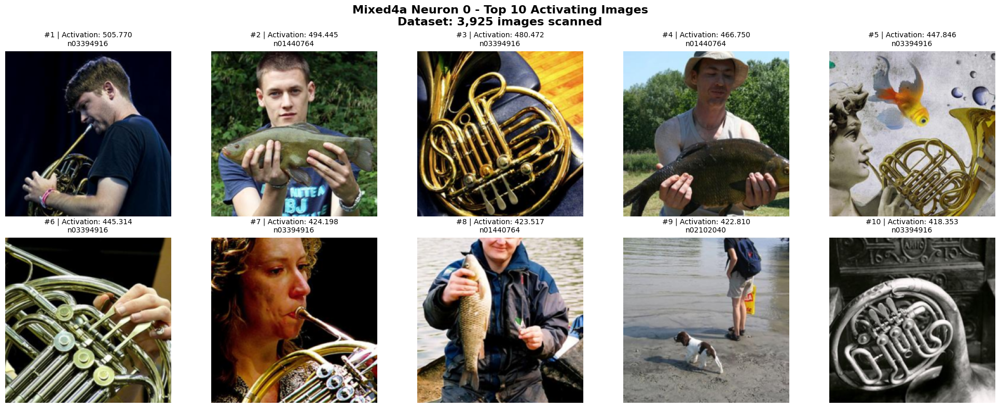

✓ Neuron 00: Max act = 505.770, 3 unique classes


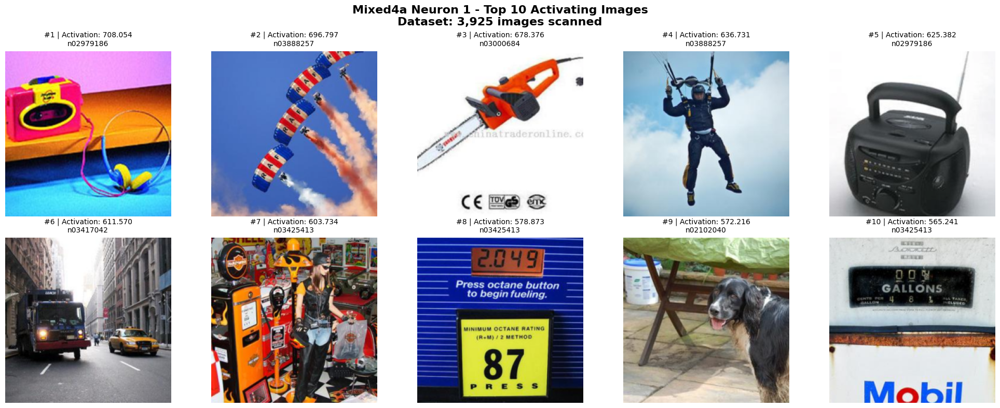

✓ Neuron 01: Max act = 708.054, 6 unique classes


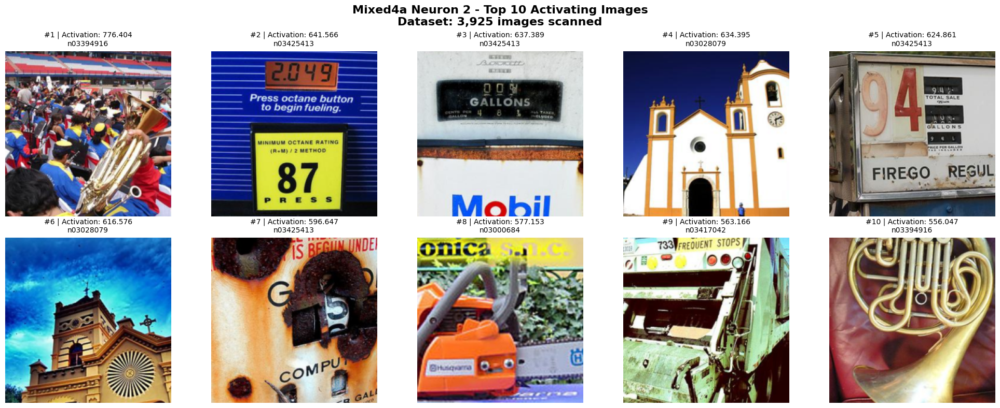

✓ Neuron 02: Max act = 776.404, 5 unique classes


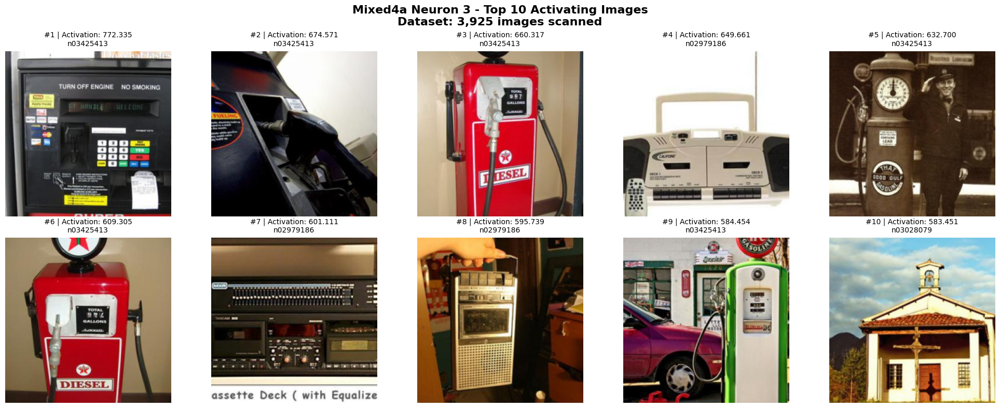

✓ Neuron 03: Max act = 772.335, 3 unique classes


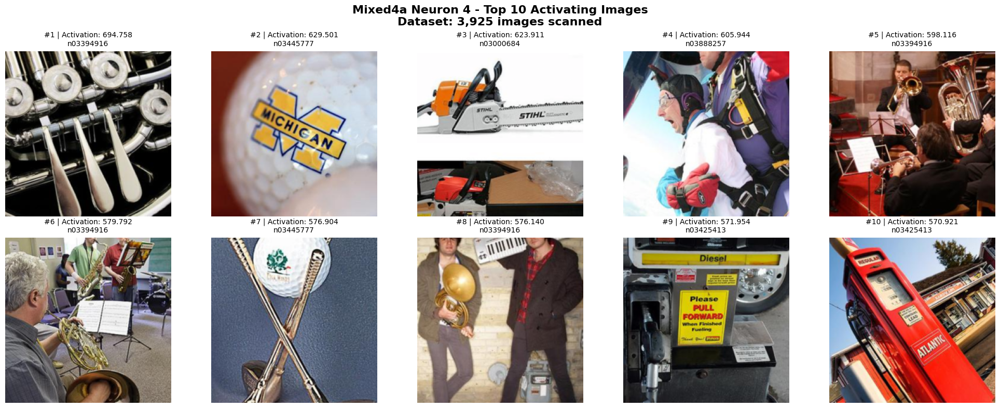

✓ Neuron 04: Max act = 694.758, 5 unique classes


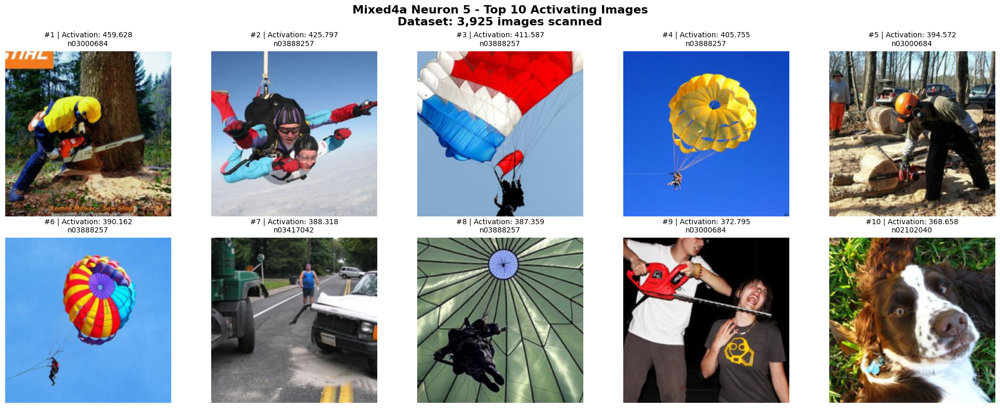

✓ Neuron 05: Max act = 459.628, 4 unique classes


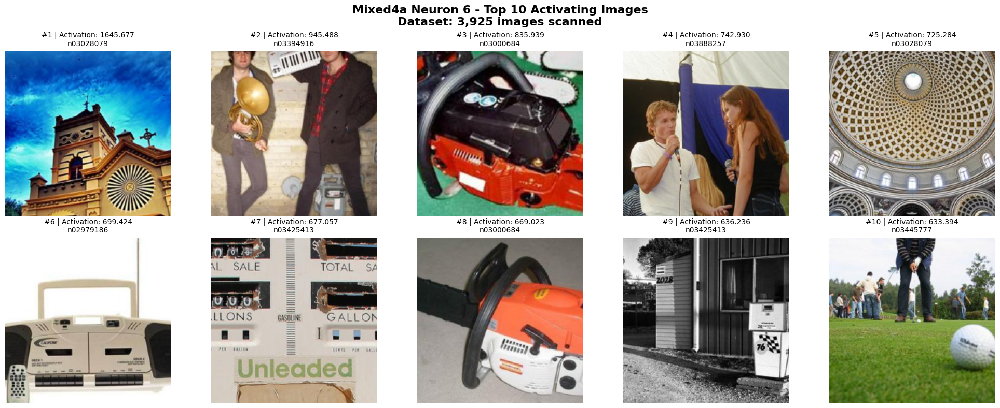

✓ Neuron 06: Max act = 1645.677, 7 unique classes


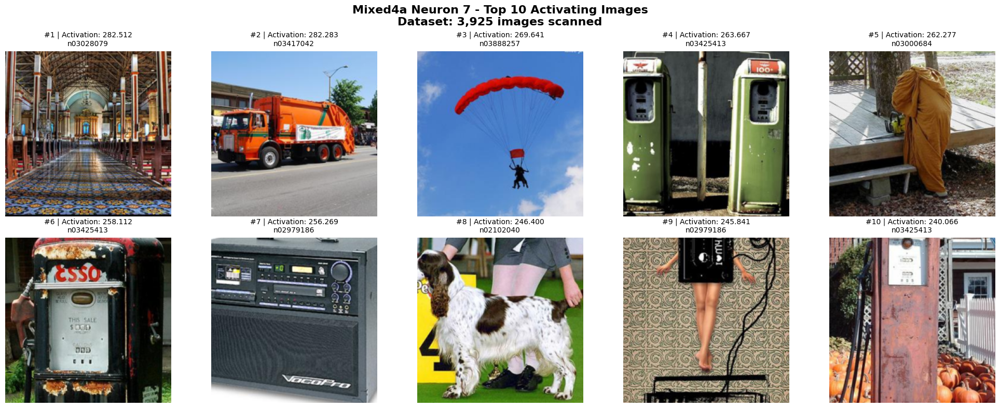

✓ Neuron 07: Max act = 282.512, 7 unique classes


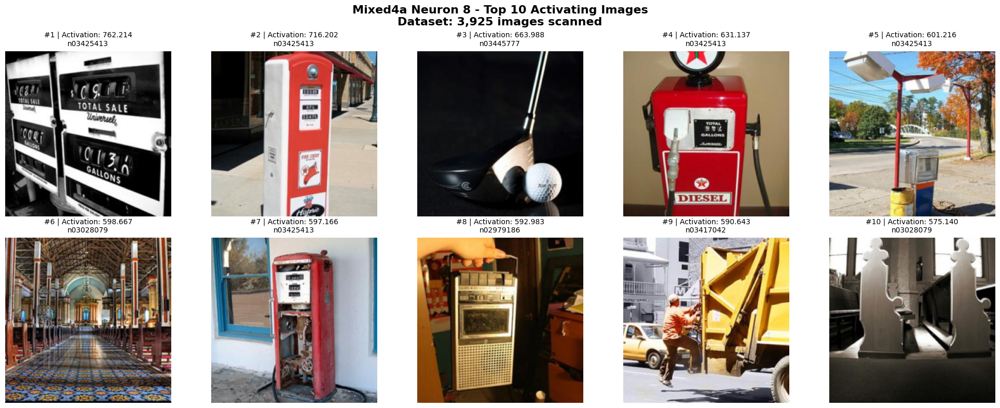

✓ Neuron 08: Max act = 762.214, 5 unique classes


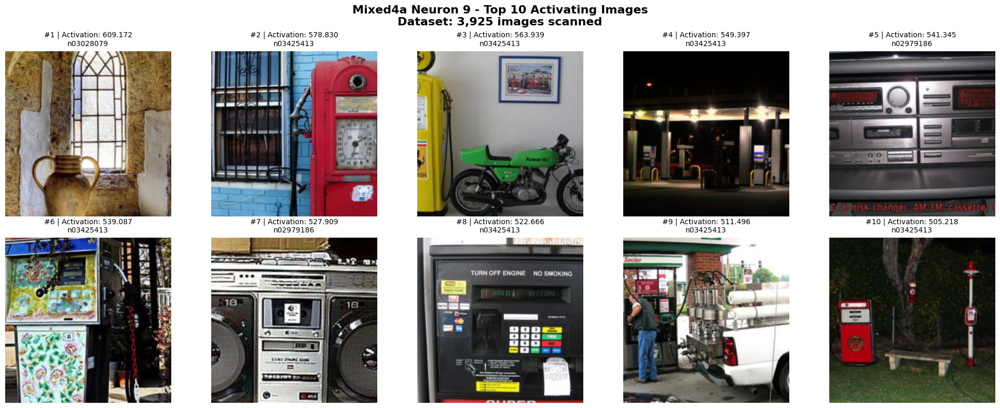

✓ Neuron 09: Max act = 609.172, 3 unique classes

💾 All visualizations saved to: segment_3_outputs/neuron_visualizations/
💾 Statistics saved: segment_3_outputs/metadata/neuron_statistics.json


In [3]:
def denormalize(tensor):
    """Convert normalized tensor back to displayable image."""
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    tensor = tensor * std + mean
    tensor = torch.clamp(tensor, 0, 1)
    return tensor.permute(1, 2, 0).numpy()

print("🎨 Generating visualizations...\n")

# Store statistics for each neuron
neuron_stats = {}

for neuron_idx in TARGET_NEURONS:
    examples = top_activations[neuron_idx]
    
    # Create visualization
    fig, axes = plt.subplots(2, 5, figsize=(20, 8))
    fig.suptitle(
        f'Mixed4a Neuron {neuron_idx} - Top 10 Activating Images\n'
        f'Dataset: {len(dataloader.dataset):,} images scanned',
        fontsize=16, 
        weight='bold'
    )
    
    # Collect stats
    activations_list = []
    class_distribution = {}
    
    for i, (act_val, class_idx, class_name, img_tensor, img_idx) in enumerate(examples):
        row, col = i // 5, i % 5
        
        # Display image
        img = denormalize(img_tensor)
        axes[row, col].imshow(img)
        axes[row, col].set_title(
            f"#{i+1} | Activation: {act_val:.3f}\n{class_name}",
            fontsize=10,
            pad=8
        )
        axes[row, col].axis('off')
        
        # Track statistics
        activations_list.append(act_val)
        class_distribution[class_name] = class_distribution.get(class_name, 0) + 1
    
    plt.tight_layout()
    
    # Save with organized naming
    output_file = IMAGES_DIR / f"neuron_{neuron_idx:02d}_top10_activations.png"
    plt.savefig(output_file, dpi=150, bbox_inches='tight')
    plt.show()
    
    # Store stats
    neuron_stats[neuron_idx] = {
        'max_activation': max(activations_list),
        'min_activation': min(activations_list),
        'mean_activation': np.mean(activations_list),
        'activation_range': max(activations_list) - min(activations_list),
        'class_distribution': class_distribution,
        'unique_classes': len(class_distribution)
    }
    
    print(f"✓ Neuron {neuron_idx:02d}: Max act = {max(activations_list):.3f}, "
          f"{len(class_distribution)} unique classes")

# Save neuron statistics
stats_file = METADATA_DIR / "neuron_statistics.json"
with open(stats_file, 'w') as f:
    json.dump(neuron_stats, f, indent=2)

print(f"\n💾 All visualizations saved to: {IMAGES_DIR}/")
print(f"💾 Statistics saved: {stats_file}")


In [4]:
print("\n" + "=" * 70)
print("📊 SEGMENT 3 ANALYSIS REPORT")
print("=" * 70)

print(f"\n📋 Dataset Information:")
print(f"   • Dataset: ImageNette (ImageNet subset)")
print(f"   • Images processed: {metadata['dataset_size']:,}")
print(f"   • Classes: {len(metadata['class_names'])}")
print(f"   • Class names: {', '.join(metadata['class_names'])}")

print(f"\n⚙️  Processing Details:")
print(f"   • Device: {metadata['device']}")
print(f"   • Processing time: {metadata['processing_time_seconds']:.2f}s "
      f"({metadata['processing_time_seconds']/60:.2f}m)")
print(f"   • Speed: {metadata['images_per_second']:.0f} images/second")

print(f"\n🔍 Per-Neuron Analysis (Mixed4a Layer):")
print(f"{'Neuron':>8} | {'Max Act':>8} | {'Range':>8} | {'Classes':>8} | Top Class")
print("-" * 70)

for neuron_idx in TARGET_NEURONS:
    stats = neuron_stats[neuron_idx]
    top_class = max(stats['class_distribution'].items(), key=lambda x: x[1])
    
    print(f"{neuron_idx:>8} | {stats['max_activation']:>8.3f} | "
          f"{stats['activation_range']:>8.3f} | {stats['unique_classes']:>8} | "
          f"{top_class[0]} ({top_class[1]}x)")

print(f"\n💡 Key Observations:")

# Find most/least selective neurons
selectivity = [(idx, neuron_stats[idx]['unique_classes']) for idx in TARGET_NEURONS]
most_diverse = max(selectivity, key=lambda x: x[1])
least_diverse = min(selectivity, key=lambda x: x[1])

print(f"   • Most diverse neuron: {most_diverse[0]} ({most_diverse[1]} different classes)")
print(f"   • Least diverse neuron: {least_diverse[0]} ({least_diverse[1]} different classes)")

# Find strongest activations
strongest = max(TARGET_NEURONS, key=lambda x: neuron_stats[x]['max_activation'])
print(f"   • Strongest activation: Neuron {strongest} "
      f"({neuron_stats[strongest]['max_activation']:.3f})")

print(f"\n📁 Output Files:")
print(f"   • Visualizations: {IMAGES_DIR}/")
for neuron_idx in TARGET_NEURONS:
    print(f"     ✓ neuron_{neuron_idx:02d}_top10_activations.png")
print(f"   • Metadata: {METADATA_DIR}/")
print(f"     ✓ collection_metadata.json")
print(f"     ✓ neuron_statistics.json")

print("\n" + "=" * 70)



📊 SEGMENT 3 ANALYSIS REPORT

📋 Dataset Information:
   • Dataset: ImageNette (ImageNet subset)
   • Images processed: 3,925
   • Classes: 10
   • Class names: n01440764, n02102040, n02979186, n03000684, n03028079, n03394916, n03417042, n03425413, n03445777, n03888257

⚙️  Processing Details:
   • Device: cpu
   • Processing time: 299.92s (5.00m)
   • Speed: 13 images/second

🔍 Per-Neuron Analysis (Mixed4a Layer):
  Neuron |  Max Act |    Range |  Classes | Top Class
----------------------------------------------------------------------
       0 |  505.770 |   87.416 |        3 | n03394916 (6x)
       1 |  708.054 |  142.813 |        6 | n03425413 (3x)
       2 |  776.404 |  220.357 |        5 | n03425413 (4x)
       3 |  772.335 |  188.884 |        3 | n03425413 (6x)
       4 |  694.758 |  123.837 |        5 | n03394916 (4x)
       5 |  459.628 |   90.969 |        4 | n03888257 (5x)
       6 | 1645.677 | 1012.283 |        7 | n03028079 (2x)
       7 |  282.512 |   42.445 |        7 | 


🔬 Generating Synthetic vs Real Comparisons...

Processing comparison for neuron 0... 

100%|██████████| 384/384 [01:29<00:00,  4.29it/s]


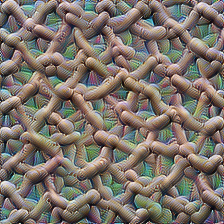

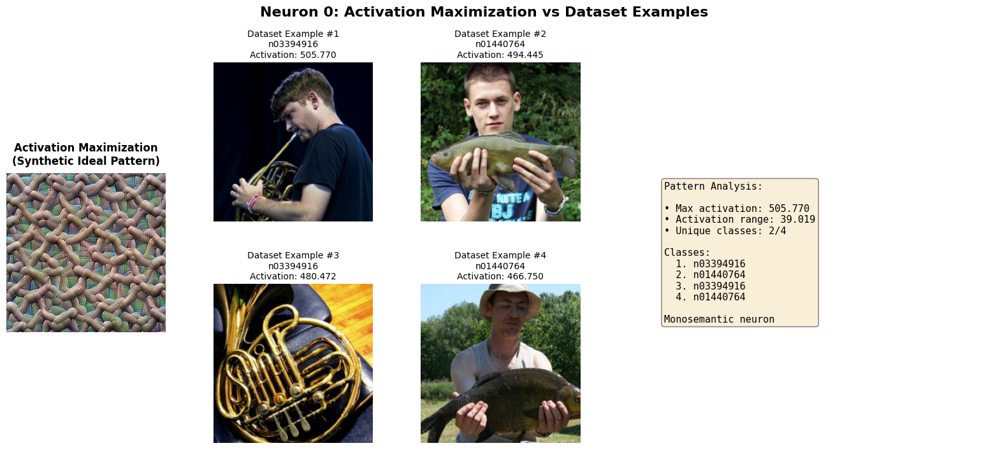

✓
Processing comparison for neuron 3... 

100%|██████████| 384/384 [01:36<00:00,  3.98it/s]


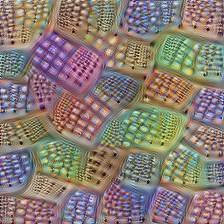

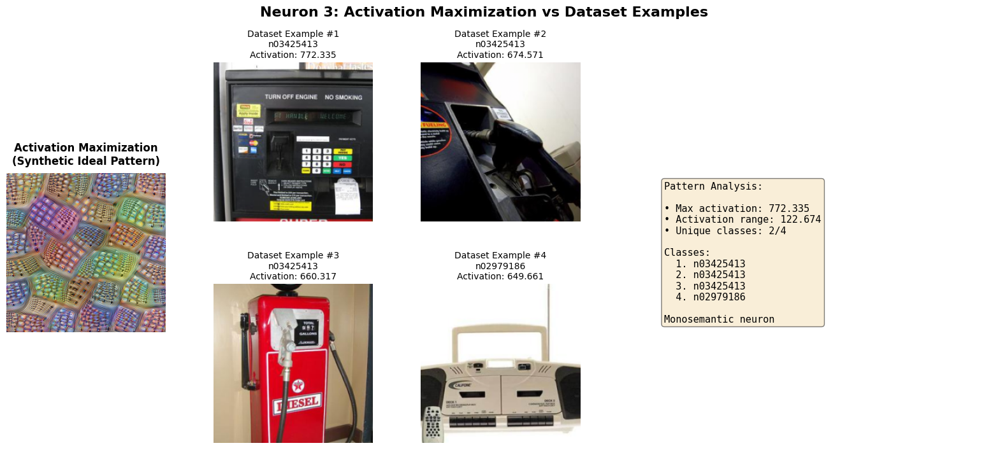

✓
Processing comparison for neuron 6... 

100%|██████████| 384/384 [01:45<00:00,  3.63it/s]


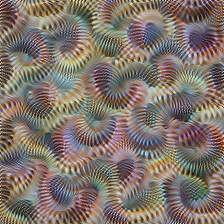

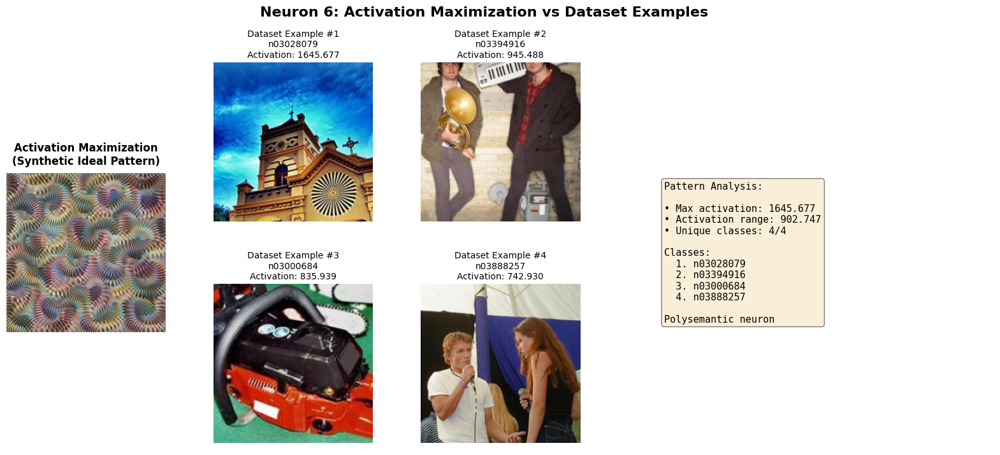

✓
Processing comparison for neuron 9... 

100%|██████████| 384/384 [01:28<00:00,  4.32it/s]


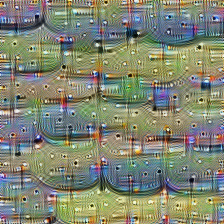

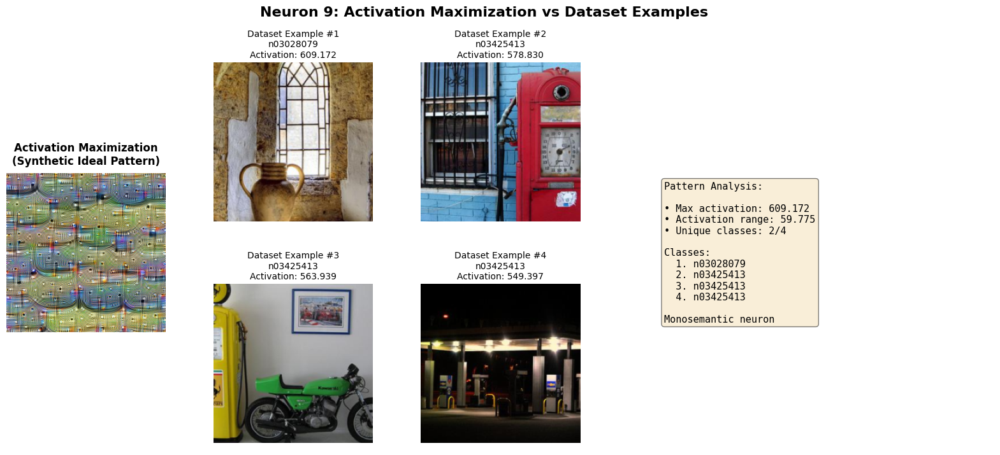

✓

💾 Comparisons saved to: segment_3_outputs/synthetic_vs_real/


In [5]:
from lucent.optvis import render, param, transform, objectives

print("\n🔬 Generating Synthetic vs Real Comparisons...\n")

def generate_activation_max(model, layer_name, neuron_idx, steps=384):
    """Generate activation maximization visualization."""
    objective = objectives.channel(layer_name, neuron_idx)
    images = render.render_vis(
        model,
        objective,
        param_f=lambda: param.image(224, fft=True, decorrelate=True),
        transforms=transform.standard_transforms,
        thresholds=[steps],
        verbose=False,
        show_inline=False
    )
    return images[0][0]

# Compare select neurons (0, 3, 6, 9 for variety)
comparison_neurons = [0, 3, 6, 9]

for neuron_idx in comparison_neurons:
    print(f"Processing comparison for neuron {neuron_idx}...", end=" ")
    
    # Generate synthetic
    syn_img = generate_activation_max(model, TARGET_LAYER, neuron_idx)
    
    # Get top 4 real examples
    real_examples = top_activations[neuron_idx][:4]
    
    # Create comparison plot
    fig = plt.figure(figsize=(20, 8))
    gs = fig.add_gridspec(2, 5, hspace=0.3, wspace=0.3)
    
    fig.suptitle(
        f'Neuron {neuron_idx}: Activation Maximization vs Dataset Examples',
        fontsize=16,
        weight='bold'
    )
    
    # Left column: Synthetic visualization (larger)
    ax_syn = fig.add_subplot(gs[:, 0])
    ax_syn.imshow(syn_img)
    ax_syn.set_title(
        'Activation Maximization\n(Synthetic Ideal Pattern)',
        fontsize=12,
        weight='bold',
        pad=10
    )
    ax_syn.axis('off')
    
    # Right columns: Real examples (2x2 grid)
    for i, (act_val, class_idx, class_name, img_tensor, img_idx) in enumerate(real_examples):
        row = i // 2
        col = i % 2 + 1
        
        ax = fig.add_subplot(gs[row, col])
        img = denormalize(img_tensor)
        ax.imshow(img)
        ax.set_title(
            f"Dataset Example #{i+1}\n{class_name}\nActivation: {act_val:.3f}",
            fontsize=10
        )
        ax.axis('off')
    
    # Add observation box
    ax_obs = fig.add_subplot(gs[:, 3:])
    ax_obs.axis('off')
    
    # Calculate pattern consistency
    classes = [ex[2] for ex in real_examples]
    unique_classes = len(set(classes))
    
    observation_text = (
        f"Pattern Analysis:\n\n"
        f"• Max activation: {real_examples[0][0]:.3f}\n"
        f"• Activation range: {real_examples[0][0] - real_examples[-1][0]:.3f}\n"
        f"• Unique classes: {unique_classes}/4\n\n"
        f"Classes:\n" + "\n".join([f"  {i+1}. {classes[i]}" for i in range(len(classes))]) +
        f"\n\n{'Monosemantic' if unique_classes <= 2 else 'Polysemantic'} neuron"
    )
    
    ax_obs.text(
        0.1, 0.5,
        observation_text,
        fontsize=11,
        verticalalignment='center',
        family='monospace',
        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    )
    
    # Save comparison
    output_file = COMPARISONS_DIR / f"neuron_{neuron_idx:02d}_synthetic_vs_real.png"
    plt.savefig(output_file, dpi=150, bbox_inches='tight')
    plt.show()
    
    print("✓")

print(f"\n💾 Comparisons saved to: {COMPARISONS_DIR}/")


In [6]:
# Generate comprehensive summary for Friday meeting
summary = {
    'segment': 3,
    'task': 'Dataset Examples',
    'completed': datetime.now().isoformat(),
    'dataset': {
        'name': 'ImageNette',
        'size': metadata['dataset_size'],
        'classes': metadata['class_names']
    },
    'processing': {
        'time_seconds': metadata['processing_time_seconds'],
        'images_per_second': metadata['images_per_second'],
        'device': metadata['device']
    },
    'analysis': {
        'layer': TARGET_LAYER,
        'neurons_analyzed': TARGET_NEURONS,
        'examples_per_neuron': TOP_K,
        'neuron_statistics': neuron_stats
    },
    'outputs': {
        'visualizations': [f"neuron_{i:02d}_top10_activations.png" for i in TARGET_NEURONS],
        'comparisons': [f"neuron_{i:02d}_synthetic_vs_real.png" for i in comparison_neurons],
        'metadata_files': ['collection_metadata.json', 'neuron_statistics.json']
    }
}

# Save summary
summary_file = OUTPUT_DIR / "segment_3_summary.json"
with open(summary_file, 'w') as f:
    json.dump(summary, f, indent=2)

print("\n" + "=" * 70)
print("✅ SEGMENT 3 COMPLETE")
print("=" * 70)
print(f"\n📦 All outputs saved in: {OUTPUT_DIR}/")
print(f"   ├─ neuron_visualizations/ ({len(TARGET_NEURONS)} files)")
print(f"   ├─ synthetic_vs_real/ ({len(comparison_neurons)} files)")
print(f"   ├─ metadata/ (2 files)")
print(f"   └─ segment_3_summary.json")
print(f"\n🚀 Ready for Friday 1/30 meeting!")
print("=" * 70)



✅ SEGMENT 3 COMPLETE

📦 All outputs saved in: segment_3_outputs/
   ├─ neuron_visualizations/ (10 files)
   ├─ synthetic_vs_real/ (4 files)
   ├─ metadata/ (2 files)
   └─ segment_3_summary.json

🚀 Ready for Friday 1/30 meeting!


In [7]:
import pandas as pd
import csv

print("📝 Generating textual data exports...\n")

# Create a detailed CSV for each neuron
CSV_DIR = OUTPUT_DIR / "data_tables"
CSV_DIR.mkdir(exist_ok=True, parents=True)

# Aggregate data structure
all_data = []

for neuron_idx in TARGET_NEURONS:
    examples = top_activations[neuron_idx]
    
    # Per-neuron CSV
    neuron_data = []
    
    print(f"Neuron {neuron_idx:02d} - Top 10 Activating Images")
    print("-" * 70)
    print(f"{'Rank':>5} | {'Image ID':>10} | {'Activation':>12} | {'Class':<20}")
    print("-" * 70)
    
    for i, (act_val, class_idx, class_name, img_tensor, img_idx) in enumerate(examples, 1):
        # Console output
        print(f"{i:>5} | {img_idx:>10} | {act_val:>12.6f} | {class_name:<20}")
        
        # CSV data
        row = {
            'neuron_id': neuron_idx,
            'rank': i,
            'image_id': img_idx,
            'activation_value': act_val,
            'class_index': class_idx,
            'class_name': class_name,
            'image_file': f"neuron_{neuron_idx:02d}_rank_{i:02d}.png"
        }
        neuron_data.append(row)
        all_data.append(row)
    
    print()
    
    # Save per-neuron CSV
    neuron_df = pd.DataFrame(neuron_data)
    neuron_csv = CSV_DIR / f"neuron_{neuron_idx:02d}_top10_data.csv"
    neuron_df.to_csv(neuron_csv, index=False)

# Save combined CSV with all neurons
combined_df = pd.DataFrame(all_data)
combined_csv = CSV_DIR / "all_neurons_top10_data.csv"
combined_df.to_csv(combined_csv, index=False)

print(f"💾 Individual neuron CSVs saved to: {CSV_DIR}/")
print(f"💾 Combined CSV saved: {combined_csv}")

# Generate summary statistics table
print("\n" + "=" * 80)
print("📊 SUMMARY STATISTICS TABLE")
print("=" * 80)
print(f"\n{'Neuron':>8} | {'Max Act':>10} | {'Min Act':>10} | {'Mean':>10} | "
      f"{'Range':>10} | {'Classes':>8} | {'Top Class':<20}")
print("-" * 80)

summary_stats = []
for neuron_idx in TARGET_NEURONS:
    stats = neuron_stats[neuron_idx]
    top_class = max(stats['class_distribution'].items(), key=lambda x: x[1])
    
    print(f"{neuron_idx:>8} | {stats['max_activation']:>10.4f} | "
          f"{stats['min_activation']:>10.4f} | {stats['mean_activation']:>10.4f} | "
          f"{stats['activation_range']:>10.4f} | {stats['unique_classes']:>8} | "
          f"{top_class[0]:<15} ({top_class[1]})")
    
    summary_stats.append({
        'neuron_id': neuron_idx,
        'max_activation': stats['max_activation'],
        'min_activation': stats['min_activation'],
        'mean_activation': stats['mean_activation'],
        'activation_range': stats['activation_range'],
        'unique_classes': stats['unique_classes'],
        'most_common_class': top_class[0],
        'most_common_class_count': top_class[1]
    })

# Save summary statistics
summary_df = pd.DataFrame(summary_stats)
summary_csv = CSV_DIR / "neuron_summary_statistics.csv"
summary_df.to_csv(summary_csv, index=False)

print(f"\n💾 Summary statistics saved: {summary_csv}")

# Generate class distribution table
print("\n" + "=" * 80)
print("🏷️  CLASS DISTRIBUTION ACROSS NEURONS")
print("=" * 80)

# Aggregate class counts across all neurons
class_totals = {}
for neuron_idx in TARGET_NEURONS:
    for class_name, count in neuron_stats[neuron_idx]['class_distribution'].items():
        class_totals[class_name] = class_totals.get(class_name, 0) + count

# Sort by frequency
sorted_classes = sorted(class_totals.items(), key=lambda x: x[1], reverse=True)

print(f"\n{'Class Name':<25} | {'Total Appearances':>18} | {'Neurons Activated':>18}")
print("-" * 80)

class_dist_data = []
for class_name, total_count in sorted_classes:
    # Count how many neurons this class appears in
    neurons_with_class = sum(1 for nid in TARGET_NEURONS 
                            if class_name in neuron_stats[nid]['class_distribution'])
    print(f"{class_name:<25} | {total_count:>18} | {neurons_with_class:>18}")
    
    class_dist_data.append({
        'class_name': class_name,
        'total_appearances': total_count,
        'neurons_activated': neurons_with_class
    })

class_dist_df = pd.DataFrame(class_dist_data)
class_dist_csv = CSV_DIR / "class_distribution.csv"
class_dist_df.to_csv(class_dist_csv, index=False)

print(f"\n💾 Class distribution saved: {class_dist_csv}")

# Generate a detailed Markdown report
print("\n📄 Generating Markdown report...")

markdown_report = OUTPUT_DIR / "SEGMENT_3_REPORT.md"

with open(markdown_report, 'w') as f:
    f.write("# Segment 3: Dataset Examples - Analysis Report\n\n")
    f.write(f"**Generated:** {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}\n\n")
    f.write("---\n\n")
    
    f.write("## Dataset Information\n\n")
    f.write(f"- **Dataset:** ImageNette (ImageNet subset)\n")
    f.write(f"- **Images processed:** {metadata['dataset_size']:,}\n")
    f.write(f"- **Classes:** {len(metadata['class_names'])}\n")
    f.write(f"- **Processing time:** {metadata['processing_time_seconds']:.2f}s\n")
    f.write(f"- **Processing speed:** {metadata['images_per_second']:.0f} images/second\n")
    f.write(f"- **Device:** {metadata['device']}\n\n")
    
    f.write("---\n\n")
    f.write("## Per-Neuron Analysis\n\n")
    
    for neuron_idx in TARGET_NEURONS:
        f.write(f"### Neuron {neuron_idx}\n\n")
        
        stats = neuron_stats[neuron_idx]
        examples = top_activations[neuron_idx]
        
        f.write(f"**Statistics:**\n")
        f.write(f"- Max activation: {stats['max_activation']:.4f}\n")
        f.write(f"- Min activation: {stats['min_activation']:.4f}\n")
        f.write(f"- Mean activation: {stats['mean_activation']:.4f}\n")
        f.write(f"- Activation range: {stats['activation_range']:.4f}\n")
        f.write(f"- Unique classes: {stats['unique_classes']}/{TOP_K}\n\n")
        
        f.write(f"**Top 10 Activating Images:**\n\n")
        f.write("| Rank | Image ID | Activation | Class |\n")
        f.write("|------|----------|------------|-------|\n")
        
        for i, (act_val, class_idx, class_name, img_tensor, img_idx) in enumerate(examples, 1):
            f.write(f"| {i} | {img_idx} | {act_val:.6f} | {class_name} |\n")
        
        f.write("\n")
        
        f.write(f"**Class Distribution:**\n")
        for class_name, count in sorted(stats['class_distribution'].items(), 
                                       key=lambda x: x[1], reverse=True):
            f.write(f"- {class_name}: {count}/{TOP_K} images\n")
        
        f.write("\n---\n\n")
    
    f.write("## Summary Statistics\n\n")
    f.write("| Neuron | Max Act | Min Act | Mean | Range | Classes | Top Class |\n")
    f.write("|--------|---------|---------|------|-------|---------|----------|\n")
    
    for stats in summary_stats:
        f.write(f"| {stats['neuron_id']} | {stats['max_activation']:.4f} | "
                f"{stats['min_activation']:.4f} | {stats['mean_activation']:.4f} | "
                f"{stats['activation_range']:.4f} | {stats['unique_classes']} | "
                f"{stats['most_common_class']} ({stats['most_common_class_count']}) |\n")
    
    f.write("\n---\n\n")
    f.write("## Files Generated\n\n")
    f.write(f"### Visualizations ({len(TARGET_NEURONS)} files)\n")
    for neuron_idx in TARGET_NEURONS:
        f.write(f"- `neuron_visualizations/neuron_{neuron_idx:02d}_top10_activations.png`\n")
    
    f.write(f"\n### Data Tables ({len(TARGET_NEURONS) + 3} files)\n")
    f.write(f"- `data_tables/all_neurons_top10_data.csv` (combined data)\n")
    f.write(f"- `data_tables/neuron_summary_statistics.csv`\n")
    f.write(f"- `data_tables/class_distribution.csv`\n")
    for neuron_idx in TARGET_NEURONS:
        f.write(f"- `data_tables/neuron_{neuron_idx:02d}_top10_data.csv`\n")

print(f"✅ Markdown report saved: {markdown_report}")

print("\n" + "=" * 80)
print("✅ TEXTUAL DATA EXPORT COMPLETE")
print("=" * 80)
print(f"\n📁 Data tables directory: {CSV_DIR}/")
print(f"   ├─ all_neurons_top10_data.csv (100 rows)")
print(f"   ├─ neuron_summary_statistics.csv")
print(f"   ├─ class_distribution.csv")
print(f"   └─ neuron_XX_top10_data.csv (10 files)")
print(f"\n📄 Markdown report: {markdown_report}")
print("=" * 80)


📝 Generating textual data exports...

Neuron 00 - Top 10 Activating Images
----------------------------------------------------------------------
 Rank |   Image ID |   Activation | Class               
----------------------------------------------------------------------
    1 |       1938 |   505.769531 | n03394916           
    2 |        180 |   494.445465 | n01440764           
    3 |       2242 |   480.471558 | n03394916           
    4 |        150 |   466.750214 | n01440764           
    5 |       2234 |   447.845947 | n03394916           
    6 |       2220 |   445.313873 | n03394916           
    7 |       2107 |   424.197968 | n03394916           
    8 |         95 |   423.517273 | n01440764           
    9 |        748 |   422.809662 | n02102040           
   10 |       2101 |   418.353363 | n03394916           

Neuron 01 - Top 10 Activating Images
----------------------------------------------------------------------
 Rank |   Image ID |   Activation | Class      

In [8]:
# Quick preview while kernel is running
print("\n📊 QUICK DATA PREVIEW\n")

# Show first 3 neurons
for neuron_idx in range(3):
    print(f"Neuron {neuron_idx}:")
    for i, (act, cls_idx, cls_name, _, img_id) in enumerate(top_activations[neuron_idx][:5], 1):
        print(f"  {i}. Image {img_id:5d} | {act:8.4f} | {cls_name}")
    print()



📊 QUICK DATA PREVIEW

Neuron 0:
  1. Image  1938 | 505.7695 | n03394916
  2. Image   180 | 494.4455 | n01440764
  3. Image  2242 | 480.4716 | n03394916
  4. Image   150 | 466.7502 | n01440764
  5. Image  2234 | 447.8459 | n03394916

Neuron 1:
  1. Image  1010 | 708.0538 | n02979186
  2. Image  3542 | 696.7973 | n03888257
  3. Image  1344 | 678.3760 | n03000684
  4. Image  3765 | 636.7308 | n03888257
  5. Image  1091 | 625.3817 | n02979186

Neuron 2:
  1. Image  2072 | 776.4044 | n03394916
  2. Image  3105 | 641.5665 | n03425413
  3. Image  2953 | 637.3886 | n03425413
  4. Image  1605 | 634.3947 | n03028079
  5. Image  2889 | 624.8611 | n03425413

